# Experiment 00: Basic EDA

See what features (channels) use. Explore the amount of data available.

In [1]:
from sz_utils import data_handler, preprocess
import matplotlib.pyplot as plt
import ydata_profiling as ydp
import pandas as pd

%matplotlib inline

In [2]:
patients = data_handler.get_patients()

In [3]:
# get seizure data for a patient
seizure_data = data_handler.get_seizure_data(patients[3])
seizure_data

,file_name,number_of_seizures,start_end_times
0,chb04_01.edf,0,NaN
1,chb04_02.edf,0,NaN
2,chb04_03.edf,0,NaN
3,chb04_04.edf,0,NaN
4,chb04_05.edf,1,"[(7804, 7853)]"
5,chb04_06.edf,0,NaN
6,chb04_07.edf,0,NaN
7,chb04_08.edf,1,"[(6446, 6557)]"
8,chb04_09.edf,0,NaN
9,chb04_10.edf,0,NaN


In [4]:
# take only the one with seizures
seizure_data = seizure_data[seizure_data["number_of_seizures"] > 0]
edfs_3_seizure = seizure_data["file_name"].values
edfs_3_seizure

array(['chb04_05.edf', 'chb04_08.edf', 'chb04_28.edf'], dtype=object)

In [5]:
# how long is the signal for the patient[3] and edf[5]?
edfs_3 = data_handler.get_patient_edf(patients[3])

# get the signal
signal_3_5 = data_handler.get_edf_data(patients[3], edfs_3[5])
signal_3_5

Extracting EDF parameters from /mnt/e/Documents/projects/seizure-prediction/data/chb-mit-scalp-eeg-database-1.0.0/chb04/chb04_06.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


/home/mnsosa/projects/SeizurePrediction/src/sz_utils/data_handler.py:75: RuntimeWarning: Channel names are not unique, found duplicates for: {'T8-P8'}. Applying running numbers for duplicates.
  mne_data = mne.io.read_raw_edf(edf_path)


,time,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,...,F8-T8,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1
0,0.000000,92.014652,-9.181929,-45.128205,50.598291,81.465201,-9.181929,-2.148962,18.168498,60.366300,...,11.916972,27.545788,-15.824176,7.228327,21.684982,45.518926,-5.665446,-38.095238,13.089133,27.545788
1,0.003906,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,...,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360
2,0.007812,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,...,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360
3,0.011719,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,...,0.195360,-0.195360,0.195360,0.195360,0.195360,0.195360,-0.195360,0.586081,0.195360,-0.195360
4,0.015625,1.367521,-1.367521,0.586081,0.976801,0.976801,0.195360,-0.195360,0.586081,0.195360,...,0.586081,0.195360,0.195360,0.195360,0.195360,-0.195360,0.586081,-0.586081,1.367521,0.195360
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3686395,14399.980469,-16.605617,15.042735,-3.711844,2.148962,-17.777778,-13.870574,3.321123,24.420024,-2.930403,...,10.744811,2.148962,2.148962,-2.539683,9.572650,4.102564,0.195360,-6.837607,12.307692,2.148962
3686396,14399.984375,-11.135531,13.479853,-6.056166,0.976801,-15.042735,-15.433455,6.446886,20.512821,-6.056166,...,0.195360,8.009768,3.321123,-2.930403,12.698413,6.446886,-9.181929,-6.837607,5.274725,8.009768
3686397,14399.988281,-8.009768,11.135531,-6.446886,0.195360,-13.870574,-15.824176,7.619048,19.340659,-8.009768,...,-4.493284,10.354090,7.228327,-3.711844,11.526252,6.837607,-11.916972,-12.698413,3.321123,10.354090
3686398,14399.992188,-4.884005,19.340659,-13.479853,-0.195360,-15.042735,-13.870574,3.321123,26.373626,-7.619048,...,-4.493284,11.135531,9.181929,-1.758242,9.572650,13.870574,-7.619048,-25.982906,0.195360,11.135531


In [6]:
# sampling is 256 Hz
# let's subsample by 3
signal_3_5 = signal_3_5[::3]
signal_3_5

,time,FP1-F7,F7-T7,T7-P7,P7-O1,FP1-F3,F3-C3,C3-P3,P3-O1,FP2-F4,...,F8-T8,T8-P8-0,P8-O2,FZ-CZ,CZ-PZ,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1
0,0.000000,92.014652,-9.181929,-45.128205,50.598291,81.465201,-9.181929,-2.148962,18.168498,60.366300,...,11.916972,27.545788,-15.824176,7.228327,21.684982,45.518926,-5.665446,-38.095238,13.089133,27.545788
3,0.011719,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,0.195360,...,0.195360,-0.195360,0.195360,0.195360,0.195360,0.195360,-0.195360,0.586081,0.195360,-0.195360
6,0.023438,-4.102564,4.884005,-1.758242,-1.758242,-2.539683,-1.367521,0.976801,-0.195360,0.195360,...,-1.758242,1.367521,-0.195360,0.195360,0.976801,2.148962,0.195360,0.195360,-2.148962,1.367521
9,0.035156,4.884005,-5.274725,2.930403,6.056166,5.274725,0.976801,-0.586081,3.321123,2.148962,...,-4.884005,9.181929,2.148962,2.539683,1.758242,-2.539683,-0.976801,-1.758242,-2.148962,9.181929
12,0.046875,-17.777778,18.168498,-4.102564,-1.758242,-8.791209,-12.307692,8.009768,7.228327,2.539683,...,-6.837607,19.731380,-1.367521,14.261294,18.949939,4.493284,11.526252,-25.201465,-2.148962,19.731380
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3686385,14399.941406,-9.181929,3.321123,-0.195360,5.274725,-10.744811,-8.400488,0.976801,17.387057,5.274725,...,-1.758242,17.387057,8.400488,4.884005,11.135531,0.586081,-4.102564,-4.493284,4.884005,17.387057
3686388,14399.953125,-12.698413,3.321123,1.758242,4.102564,-16.996337,-9.181929,2.148962,20.903541,0.586081,...,2.148962,14.652015,5.274725,0.976801,10.354090,-1.367521,-2.539683,2.539683,4.884005,14.652015
3686391,14399.964844,-15.042735,5.274725,2.148962,1.367521,-10.354090,-17.387057,2.148962,19.731380,-0.976801,...,3.711844,9.572650,3.321123,0.586081,4.102564,-1.758242,-2.930403,5.274725,5.274725,9.572650
3686394,14399.976562,-15.824176,6.056166,0.195360,2.148962,-14.652015,-18.949939,6.056166,19.731380,-1.758242,...,5.274725,6.056166,0.195360,-2.930403,6.056166,0.195360,-4.493284,3.711844,9.572650,6.056166


In [7]:
profile_3_5 = ydp.ProfileReport(signal_3_5)
profile_3_5

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


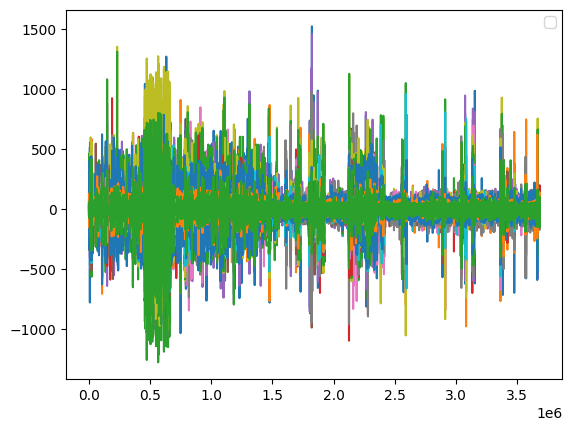

In [8]:
# Alert: highly correlated

# ploting the signal

plt.plot(signal_3_5.drop("time", axis=1))
plt.legend()
plt.show()

In [15]:
# does all the patients have the same channels?
# all edfs
edfs = [data_handler.get_patient_edf(p) for p in patients]

In [16]:
%%capture

# from all edfs, get the columns (channels) for each edf
edfs_columns = [data_handler.get_edf_data(p, e).columns for p, edfs in zip(patients, edfs) for e in edfs]

In [19]:
edfs_columns

[Index(['time', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3',
        'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
        'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10',
        'FT10-T8', 'T8-P8-1'],
       dtype='object'),
 Index(['time', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3',
        'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
        'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10',
        'FT10-T8', 'T8-P8-1'],
       dtype='object'),
 Index(['time', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3',
        'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
        'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10',
        'FT10-T8', 'T8-P8-1'],
       dtype='object'),
 Index(['time', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3',
        'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8

In [35]:
# what are the columns in common?
# get the intersection of all the columns
common_cols = set.intersection(*map(set, edfs_columns))

{'time'}

In [69]:
# mmmmm... let's see the frequency of the columns
from collections import Counter


# count the frequency of each column
counter = Counter([col for cols in edfs_columns for col in cols])
counter


Counter({'time': 686,
         'FP1-F7': 683,
         'F7-T7': 683,
         'T7-P7': 683,
         'P7-O1': 683,
         'FP1-F3': 683,
         'F3-C3': 683,
         'C3-P3': 683,
         'P3-O1': 683,
         'FP2-F4': 683,
         'F4-C4': 683,
         'C4-P4': 683,
         'P4-O2': 683,
         'FP2-F8': 683,
         'F8-T8': 683,
         'T8-P8-0': 655,
         'P8-O2': 683,
         'FZ-CZ': 683,
         'CZ-PZ': 683,
         'P7-T7': 655,
         'T7-FT9': 655,
         'FT9-FT10': 655,
         'FT10-T8': 655,
         'T8-P8-1': 655,
         'ECG': 36,
         'VNS': 18,
         '--0': 292,
         '--1': 292,
         '--2': 292,
         '--3': 292,
         '--4': 264,
         'F7-CS2': 1,
         'T7-CS2': 1,
         'P7-CS2': 1,
         'FP1-CS2': 1,
         'F3-CS2': 1,
         'C3-CS2': 1,
         'P3-CS2': 1,
         'O1-CS2': 1,
         'FZ-CS2': 1,
         'CZ-CS2': 1,
         'PZ-CS2': 1,
         'FP2-CS2': 1,
         'F4-CS2': 1,
  

In [1]:
features = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1', 
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2', 
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8']

len(features)

22

In [72]:
# so we decide to use this features
features = ['FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3', 'P3-O1', 
            'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8', 'T8-P8-0', 'P8-O2', 
            'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1', 'ECG']

# save the features
with open("../../features_list.pkl", "wb") as f:
    pickle.dump(features, f)

In [12]:
signal_3_5.columns

Index(['time', 'FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3', 'C3-P3',
       'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
       'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10',
       'FT10-T8', 'T8-P8-1'],
      dtype='object')

In [18]:
signal_3_5["T8-P8-0"]

0          27.545788
3          -0.195360
6           1.367521
9           9.181929
12         19.731380
             ...    
3686385    17.387057
3686388    14.652015
3686391     9.572650
3686394     6.056166
3686397    10.354090
Name: T8-P8-0, Length: 1228800, dtype: float64

In [24]:
# check what about T8-P8-0 and T8-P8-1
all(signal_3_5['T8-P8-1'] == signal_3_5['T8-P8-0'])

True

In [ ]:
# we decide to drop one of them and keep the other